## Load In Dependencies

In [1]:
# Supress Warnings
import warnings
warnings.filterwarnings('ignore')

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.basemap import Basemap
import folium

# Data Science
import numpy as np
import pandas as pd
import statsmodels.api as sm
import statsmodels.formula.api as smf

# Multi-dimensional arrays and datasets
import xarray as xr

# Geospatial raster data handling
import rioxarray as rxr

# Geospatial data analysis
import geopandas as gpd

# Geospatial operations
import rasterio
from rasterio import windows  
from rasterio import features  
from rasterio import warp
from rasterio.warp import transform_bounds 
from rasterio.windows import from_bounds 

# Image Processing
from PIL import Image

# Coordinate transformations
from pyproj import Proj, Transformer, CRS

# Feature Engineering
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Machine Learning
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score

# Planetary Computer Tools
import pystac_client
import planetary_computer as pc
from pystac.extensions.eo import EOExtension as eo

# Others
import os
from tqdm import tqdm


In [2]:
import yaml

with open("../data_pipeline/config.yaml", "r") as file:
    config = yaml.safe_load(file)

COORDS = config['coords']

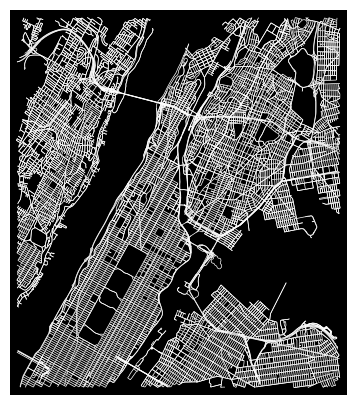

In [4]:
import osmnx as ox
import matplotlib.pyplot as plt
from shapely.geometry import box

# Get the graph
bbox = box(*COORDS)

# G = ox.graph_from_polygon(bbox, network_type='drive')

# Plot the graph
ox.plot_graph(G, figsize=(5, 5), bgcolor='k', node_size=0, edge_color='w', edge_linewidth=0.5)
plt.show()


In [18]:
COORDS

[-74.01, 40.75, -73.86, 40.88]

In [3]:
df = gpd.read_file("../data_pipeline/data/features_extracted/street.geojson")
df.head()

,OBJECTID,Join_ID,StreetCode,Street,TrafDir,StreetWidth_Min,StreetWidth_Max,street_width_avg,RW_TYPE,POSTED_SPEED,...,Number_Park_Lanes,Number_Total_Lanes,FeatureTyp,SegmentTyp,BikeLane,BIKE_TRAFDIR,TRUCK_ROUTE_TYPE,Shape__Length,direction,geometry
0,1,2251001000000,226700,EAST 168 STREET,T,34.0,34.0,34.0,1,25.0,...,2.0,4.0,0,U,NaN,None,NaN,396.030947,NW-SE,"LINESTRING (-73.90347 40.83036, -73.90238 40.8..."
1,2,2798401000000,274810,WEST 192 STREET,A,30.0,30.0,30.0,1,25.0,...,2.0,3.0,0,U,NaN,None,NaN,279.360514,NW-SE,"LINESTRING (-73.9012 40.86662, -73.90207 40.86..."
2,3,2728001000000,270420,UNION AVENUE,W,34.0,34.0,34.0,1,25.0,...,2.0,3.0,0,U,NaN,None,NaN,618.327133,NE-SW,"LINESTRING (-73.90118 40.8244, -73.90051 40.82..."
3,4,21279502000000X,270420,UNION AVENUE,W,34.0,34.0,34.0,1,25.0,...,2.0,3.0,0,U,NaN,None,NaN,618.327133,NE-SW,"LINESTRING (-73.90118 40.8244, -73.90051 40.82..."
4,5,21279503000000X,270420,UNION AVENUE,W,34.0,34.0,34.0,1,25.0,...,2.0,3.0,0,U,NaN,None,NaN,618.327133,NE-SW,"LINESTRING (-73.90118 40.8244, -73.90051 40.82..."


<Axes: >

<Figure size 1500x1500 with 0 Axes>

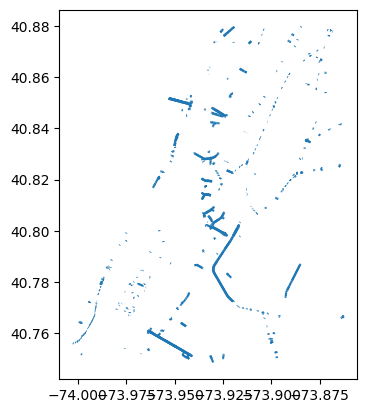

In [37]:
plt.figure(figsize=(15, 15))
df[df['RW_TYPE'].astype('int').isin([3])].plot()

In [ ]:
import momepy
import networkx as nx

# G = ox.graph_from_polygon(bbox, network_type='drive')
# G_proj = ox.project_graph(G, to_crs="EPSG:26918")  # Taiwan EPSG:3826 (meters)

degree_dict = dict(G_proj.degree())
nx.set_node_attributes(G_proj, degree_dict, "degree")

# --- 4. Convert to GeoDataFrames ---
nodes, edges = ox.graph_to_gdfs(G_proj)

In [118]:
# edges['orientation'] = momepy.Orientation(edges).series

# edges['straight'] = edges.geometry.apply(lambda geom: geom.coords[0])
# edges['straight_end'] = edges.geometry.apply(lambda geom: geom.coords[-1])
# edges['straight_dist'] = edges.apply(
#     lambda row: np.linalg.norm(np.array(row['straight']) - np.array(row['straight_end'])),
#     axis=1
# )

# # Calculate circuity per edge
# edges['circuity'] = edges['length'] / edges['straight_dist']
# edges['circuity'].replace([np.inf, -np.inf], np.nan, inplace=True)

# closeness_series = momepy.closeness_centrality(G_proj, radius=1000, distance="length", weight="length")
closeness_series = momepy.closeness_centrality(closeness_series, radius=100, name="closeness_500", 
                                               distance="length", weight="length")
# nodes['closeness_1000'] = closeness_series


  0%|          | 0/11141 [00:00<?, ?it/s]

In [82]:
momepy.nx_to_gdf(primal, lines=True)[1][['u', 'v', 'node_start', 'node_end']]

,u,v,node_start,node_end
0,42421728,42435337,0,1
1,42435337,42421728,0,1
2,42421728,42421731,0,2
3,42421731,42421728,0,2
4,42421728,42432736,0,3
...,...,...,...,...
26334,9819132058,10578059104,11126,11127
26335,9819132058,10578059100,11126,11128
26336,10578059100,10578059104,11127,11128
26337,10578059100,11710127261,11128,11137


In [ ]:
a.geometry

AttributeError: 'GeoSeries' object has no attribute 'coords'

In [158]:
print(a.columns)

Index(['osmid', 'name', 'highway', 'maxspeed', 'oneway', 'reversed', 'length',
       'geometry', 'lanes', 'ref', 'access', 'bridge', 'width', 'tunnel',
       'junction', 'node_start', 'node_end', 'straight'],
      dtype='object')


In [4]:
data['orientation'].describe()

count    20997.000000
mean        24.579411
std         11.076683
min          0.000000
25%         16.369371
50%         28.131016
75%         31.432014
max         44.997742
Name: orientation, dtype: float64

In [10]:
(data['degree'] >= 3).sum()

10415

In [27]:
data = gpd.read_file("../data_pipeline/data/raw/surface_elevation.geojson")

In [28]:
data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 376133 entries, 0 to 376132
Data columns (total 6 columns):
 #   Column     Non-Null Count   Dtype   
---  ------     --------------   -----   
 0   elevation  376133 non-null  object  
 1   feat_code  376133 non-null  object  
 2   status     376133 non-null  object  
 3   sub_code   376133 non-null  object  
 4   source_id  376133 non-null  object  
 5   geometry   376133 non-null  geometry
dtypes: geometry(1), object(5)
memory usage: 17.2+ MB


In [13]:
import geopandas as gpd

data = gpd.read_file("../data_pipeline/data/raw/railroad_line.geojson")
data.head()

,name,shape_leng,feat_code,status,sub_code,source_id,geometry
0,PITKIN YARD,60.8123511995,2400,Unchanged,240010,20240000810.0,"MULTILINESTRING ((-73.86531 40.67207, -73.8652..."
1,BMT P CANARSIE,1113.00260085,2410,Unchanged,241000,20241000284.0,"MULTILINESTRING ((-73.90327 40.6744, -73.90328..."
2,BMT J JAMAICA,567.546882005,2410,Unchanged,241000,20241000232.0,"MULTILINESTRING ((-73.87306 40.68642, -73.8730..."
3,LONG ISLAND RR,163.341647216,2410,Unchanged,241000,20241000425.0,"MULTILINESTRING ((-73.92584 40.63834, -73.9258..."
4,BMT AY CANARSIE,56.3673812964,2400,Unchanged,240000,20240000530.0,"MULTILINESTRING ((-73.90058 40.64861, -73.9005..."


In [46]:
import geopandas as gpd

data = gpd.read_file("../data_pipeline/data/raw/tree_points.geojson")
data.head()

,tpcondition,stumpdiameter,riskratingdate,riskrating,objectid,globalid,tpstructure,plantingspaceglobalid,createddate,dbh,planteddate,updateddate,geometry,genusspecies
0,Excellent,None,NaT,None,86823,2B457A4C-E0E4-4E17-81C4-A5449F51C804,Full,E814CD37-9F53-4D79-AF86-3B454F9D29B9,2015-02-28 05:00:00,20,None,2016-10-20 17:43:53,POINT (-73.81657 40.71629),Acer nigrum - black maple
1,Good,None,NaT,None,87623,37195E1A-A7EE-4AA4-8389-19A0ED5C46F7,Retired,A644AB79-A3CB-4F7F-923B-F308E615CCD4,2015-03-03 05:00:00,10,None,2019-09-18 13:12:55,POINT (-73.93848 40.81299),Fraxinus pennsylvanica - Green ash
2,Poor,None,NaT,None,88023,6BA8E72B-1901-4EF3-ABFF-D11680AB4A9B,Retired,21431016-EDB8-4A0B-B122-673125800C87,2015-03-03 05:00:00,24,None,2018-03-27 14:00:42,POINT (-73.83244 40.88763),Acer platanoides - Norway maple
3,Fair,None,2024-06-28 12:41:55,6,88823,79A5DBAF-F305-4DA1-A4B1-7A8C8D085435,Full,96FB6C55-612F-466D-9449-85A3CD2178E1,2015-03-04 05:00:00,10,None,2024-06-28 12:41:55,POINT (-74.20904 40.51958),Pyrus calleryana - Callery pear
4,Dead,None,NaT,None,88824,182F6647-D9C1-4A45-ADA0-9ADEFD1ECC60,Retired,4796B64F-906C-4345-A4E9-5CD6133642F8,2015-03-04 05:00:00,10,None,2016-10-24 02:50:43,POINT (-73.98032 40.74291),Gleditsia triacanthos var. inermis - Thornless...


In [62]:
data['tpcondition'].value_counts()

tpcondition
Good         103533
Fair          49400
Dead          22335
Excellent     19097
Poor           7283
Unknown        4590
Critical       1271
Name: count, dtype: int64

In [61]:
data['genusspecies'].value_counts(normalize=True).to_dict()

{'Gleditsia triacanthos var. inermis - Thornless honeylocust': 0.10795010940075375,
 'Platanus x acerifolia - London planetree': 0.07925048435135473,
 'Quercus palustris - pin oak': 0.06973695624933733,
 'Pyrus calleryana - Callery pear': 0.049856863330987884,
 'Zelkova serrata - Japanese zelkova': 0.04536516718555717,
 'Tilia cordata - littleleaf linden': 0.03808302890685996,
 'Ginkgo biloba - maidenhair tree': 0.03655045447097265,
 'Unknown - Unknown': 0.03545162751694025,
 'Styphnolobium japonicum - Japanese pagoda tree': 0.03056955863784013,
 'Ulmus americana - American elm': 0.023995874579505912,
 'Acer platanoides - Norway maple': 0.021750026506790556,
 'Quercus rubra - northern red oak': 0.021441583853027076,
 'Tilia americana - American basswood': 0.01664144505383288,
 "Prunus serrulata 'Green leaf' - 'Green leaf' Japanese flowering cherry": 0.016386015981184998,
 'Acer rubrum - red maple': 0.015441410354034334,
 'Quercus bicolor - swamp white oak': 0.015084773535620308,
 'Frax

In [47]:
COORDS =  [-74.01, 40.75, -73.86, 40.88]
data = data.cx[COORDS[0]:COORDS[2], COORDS[1]:COORDS[3]]

<Axes: >

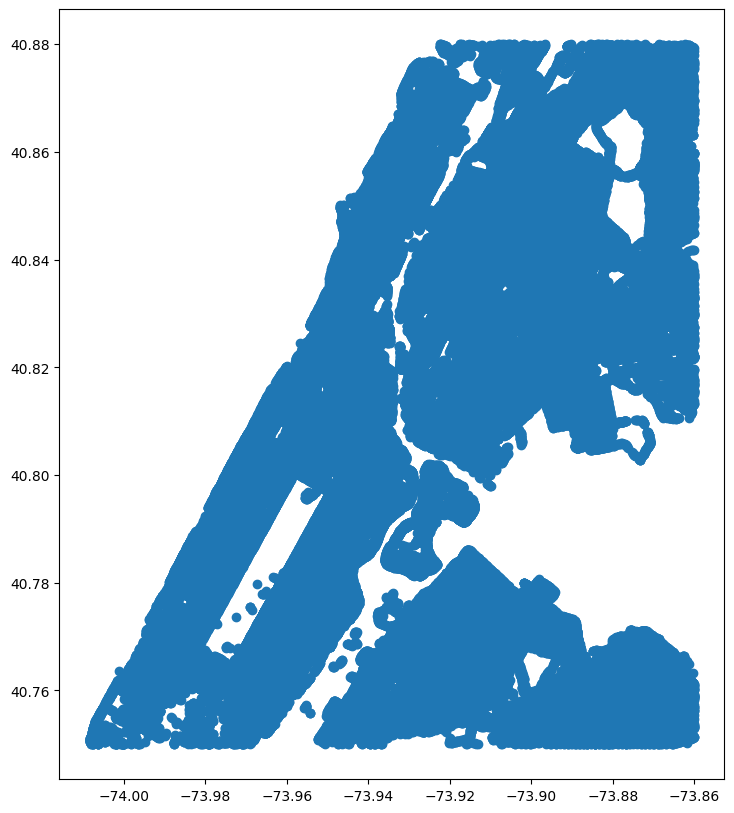

In [54]:
data.plot(figsize=(10, 10))

In [31]:
data['gi_id'].value_counts()

gi_id
RG-2          21
RG-1          20
RG-3          15
RG-4          15
RG-5          11
              ..
1-IB297-1a     1
1654C          1
IB1139a        1
IB001C         1
H-89a          1
Name: count, Length: 13002, dtype: int64

In [20]:
data = pd.read_csv("../data_pipeline/data/raw/cooling_tower.csv")
data

,BIN,system_id,Date_Registered,Address,Borough,Zip_Code,Sample_Dates,Active_Equip,BBL,Latitude,Longitude,Community_Board,Council_District,Census_Tract,NTA_Code
0,1001129,2000000001,2015-08-28,104 JOHN STREET,Manhattan,10038,NaN,1,1000690051,40.707710,-74.006226,101,1,1502.0,MN25
1,1001116,2000000002,2015-08-28,100 WILLIAM ST,Manhattan,10038,"04/17/2024, 07/09/2024, 08/01/2024, 08/26/2024...",1,1000680036,40.708347,-74.007202,101,1,1502.0,MN25
2,1075741,2000000003,2015-09-15,109 LAFAYETTE STREET,Manhattan,10013,"05/29/2024, 08/27/2024",1,1001977501,40.717926,-74.000595,101,1,3100.0,MN24
3,1015267,2000000004,2015-09-11,109 W.38 STREET,Manhattan,10018,NaN,3,1008140030,40.752728,-73.986343,105,4,11300.0,MN17
4,1083631,2000000005,2015-09-01,10 W 33RD ST,Manhattan,10001,"05/03/2024, 05/13/2024, 06/05/2024, 07/30/2024...",1,1008340049,40.747845,-73.985794,105,4,7600.0,MN17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4936,4003517,2000015805,2025-01-15,30-2 THOMSON AVENUE,Queens,11101,NaN,1,4002740001,40.744171,-73.936996,402,26,17900.0,QN31
4937,1028789,2000015808,2025-01-28,335 COLUMBUS AVE,Manhattan,10023,"12/02/2024, 02/12/2025",1,1011280061,40.779800,-73.977028,107,6,16100.0,MN12
4938,4437659,2000015809,2025-02-04,81-29 LEFFERTS BLVD,Queens,11415,NaN,1,4033380006,40.708794,-73.830521,409,29,13600.0,QN60
4939,1079184,2000015810,2025-02-12,261 11TH AVE,Manhattan,10001,NaN,1,1006730001,40.751495,-74.005119,104,3,9900.0,MN13


In [21]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4941 entries, 0 to 4940
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   BIN               4941 non-null   int64  
 1   system_id         4941 non-null   int64  
 2   Date_Registered   4941 non-null   object 
 3   Address           4941 non-null   object 
 4   Borough           4941 non-null   object 
 5   Zip_Code          4941 non-null   object 
 6   Sample_Dates      4131 non-null   object 
 7   Active_Equip      4941 non-null   int64  
 8   BBL               4941 non-null   int64  
 9   Latitude          4941 non-null   float64
 10  Longitude         4941 non-null   float64
 11  Community_Board   4941 non-null   int64  
 12  Council_District  4941 non-null   int64  
 13  Census_Tract      4933 non-null   float64
 14  NTA_Code          4933 non-null   object 
dtypes: float64(3), int64(6), object(6)
memory usage: 579.2+ KB


In [11]:
data['feat_code'].value_counts()

feat_code
2400    6363
2410    2591
2420    2410
2440    1646
2450    1047
2465     299
2430      72
Name: count, dtype: int64

In [3]:
data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2206 entries, 0 to 2205
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   name        1844 non-null   object  
 1   shape_area  2206 non-null   object  
 2   shape_leng  2206 non-null   object  
 3   feat_code   2206 non-null   object  
 4   status      2206 non-null   object  
 5   sub_code    2206 non-null   object  
 6   source_id   2206 non-null   object  
 7   geometry    2206 non-null   geometry
dtypes: geometry(1), object(7)
memory usage: 138.0+ KB


In [144]:
from shapely.geometry import LineString

a['straight'] = a.geometry.apply(lambda geom: geom.coords[0] if geom is not None and isinstance(geom, LineString) else None)

In [130]:
a = momepy.nx_to_gdf(closeness_series)[1]

In [104]:
nodes, edges = momepy.nx_to_gdf(G_proj)

In [98]:
primal = momepy.gdf_to_nx(edges, approach="primal")
primal = momepy.straightness_centrality(primal)

straightness = momepy.nx_to_gdf(primal, points=False)
ax = nodes.plot(
    column="straightness",
    cmap="Spectral_r",
    scheme="quantiles",
    k=15,
    alpha=0.6,
    figsize=(15, 15),
)
ax.set_axis_off()
_ = ax.set_title("straightness")

KeyboardInterrupt: 

In [95]:
momepy.nx_to_gdf(node_primal, points=True)[0]

,x,y,closeness400,nodeID,geometry
0,587729.043733,4.516859e+06,0.000015,0,POINT (587729.044 4516859.09)
1,587688.489794,4.516784e+06,0.000014,1,POINT (587688.49 4516784.068)
2,587607.544456,4.516925e+06,0.000017,2,POINT (587607.544 4516924.975)
3,587770.034445,4.516935e+06,0.000016,3,POINT (587770.034 4516934.917)
4,587566.635486,4.516849e+06,0.000016,4,POINT (587566.635 4516849.227)
...,...,...,...,...,...
11136,596086.864243,4.520838e+06,0.000020,11136,POINT (596086.864 4520837.596)
11137,595695.232700,4.513985e+06,0.000013,11137,POINT (595695.233 4513984.582)
11138,594190.268889,4.525950e+06,0.000012,11138,POINT (594190.269 4525949.653)
11139,594270.662765,4.521550e+06,0.000025,11139,POINT (594270.663 4521549.798)


In [128]:
# node_primal = momepy.gdf_to_nx(edges, approach="primal")
node_primal = momepy.betweenness_centrality(
    G_proj, radius=100, name="closeness400", mode="edges", weight="length"
)

edge_centrality = momepy.nx_to_gdf(closeness_series, points=False)
ax = edge_centrality.plot(
    column="closeness400",
    cmap="Spectral_r",
    scheme="quantiles",
    k=10,
    alpha=0.6,
    figsize=(15, 15),
)
# ax.set_axis_off()
_ = ax.set_title("closeness_1000")


  0%|          | 0/11141 [00:00<?, ?it/s]

KeyboardInterrupt: 

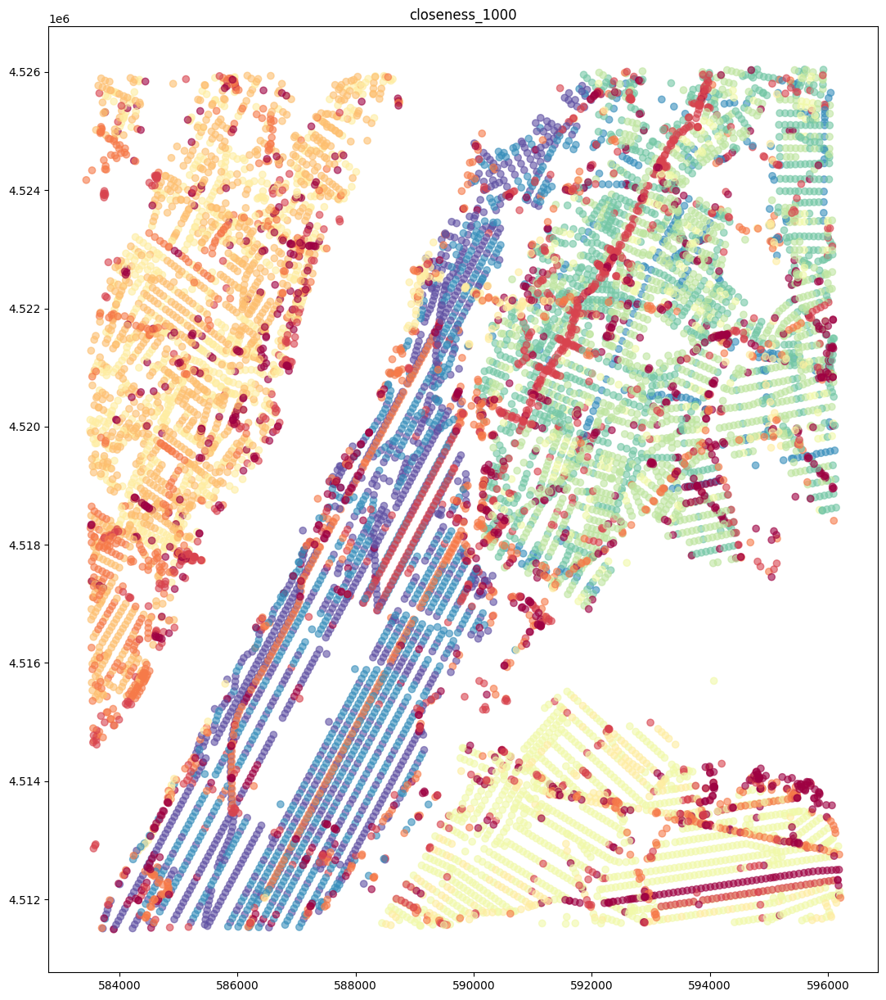

In [ ]:
ax = nodes.plot(
    column="closeness_1000",
    cmap="Spectral_r",
    scheme="quantiles",
    k=10,
    alpha=0.6,
    figsize=(15, 15),
)
# ax.set_axis_off()
_ = ax.set_title("closeness_1000")

In [34]:
edges

osmid  \
u           v           key                                         
42421728    42435337    0                               195743153   
            42421731    0         [420625565, 420625573, 5668966]   
            42432736    0                [1271523197, 1271523198]   
42435337    42437916    0                                 5670640   
            42421728    0                               195743153   
...                                                           ...   
12007768231 42757772    0                    [274458856, 5699476]   
            12007780878 0    [1295844037, 1295844038, 1295837117]   
12055955032 12055955035 0                                 5698219   
            42728196    0                               274458291   
12456262129 12456262141 0                              1346666876   

                                                                          name  \
u           v           key                                                      
42421728    42435337    0                                    Central Park West   
            42421731    0                                    West 106th Street   
            42432736    0                                    Central Park West   
42435337    42437916    0                                    West 105th Street   
            42421728    0                                    Central Park West   
...                                                                        ...   
12007768231 42757772    0    [Boone Avenue, Cross Bronx Expressway Service ...   
            12007780878 0                                          Boston Road   
12055955032 12055955035 0                                    West 175th Street   
            42728196    0                                        Popham Avenue   
12456262129 12456262141 0                                         Grand Avenue   

                                                 highway maxspeed  oneway  \
u           v           key                                                 
42421728    42435337    0                      secondary   25 mph   False   
            42421731    0                      secondary      NaN   False   
            42432736    0                      secondary   25 mph   False   
42435337    42437916    0                    residential   25 mph    True   
            42421728    0                      secondary   25 mph   False   
...                                                  ...      ...     ...   
12007768231 42757772    0    [residential, unclassified]      NaN    True   
            12007780878 0                   unclassified      NaN    True   
12055955032 12055955035 0                    residential      NaN    True   
            42728196    0                    residential      NaN    True   
12456262129 12456262141 0                    residential      NaN   False   

                            reversed   length  \
u           v           key                     
42421728    42435337    0       True   85.345   
            42421731    0      False  138.033   
            42432736    0      False   86.275   
42435337    42437916    0      False  137.996   
            42421728    0      False   85.345   
...                              ...      ...   
12007768231 42757772    0      False  469.217   
            12007780878 0      False   51.801   
12055955032 12055955035 0      False   79.180   
            42728196    0      False  122.888   
12456262129 12456262141 0       True   17.172   

                                                                      geometry  \
u           v           key                                                      
42421728    42435337    0    LINESTRING (587729.044 4516859.09, 587723.438 ...   
            42421731    0    LINESTRING (587729.044 4516859.09, 587718.659 ...   
            42432736    0    LINESTRING (587729.044 4516859.09, 587735.426 ...   
42435337    42437916    0    LINESTRING (5876

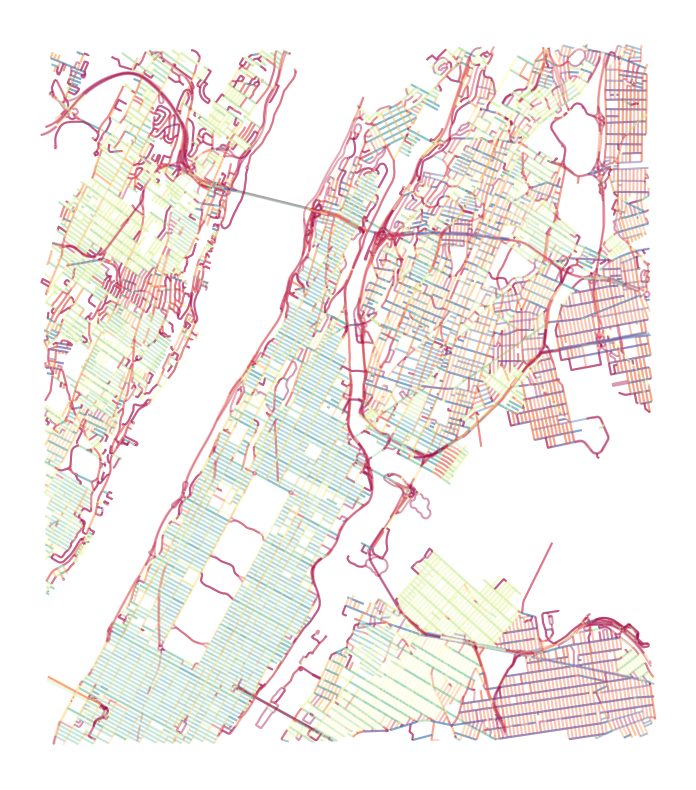

In [37]:
ax = edges.plot(
    column="circuity",
    cmap="Spectral_r",
    scheme="quantiles",
    k=15,
    alpha=0.4,
    figsize=(10, 10),
)
ax.set_axis_off()

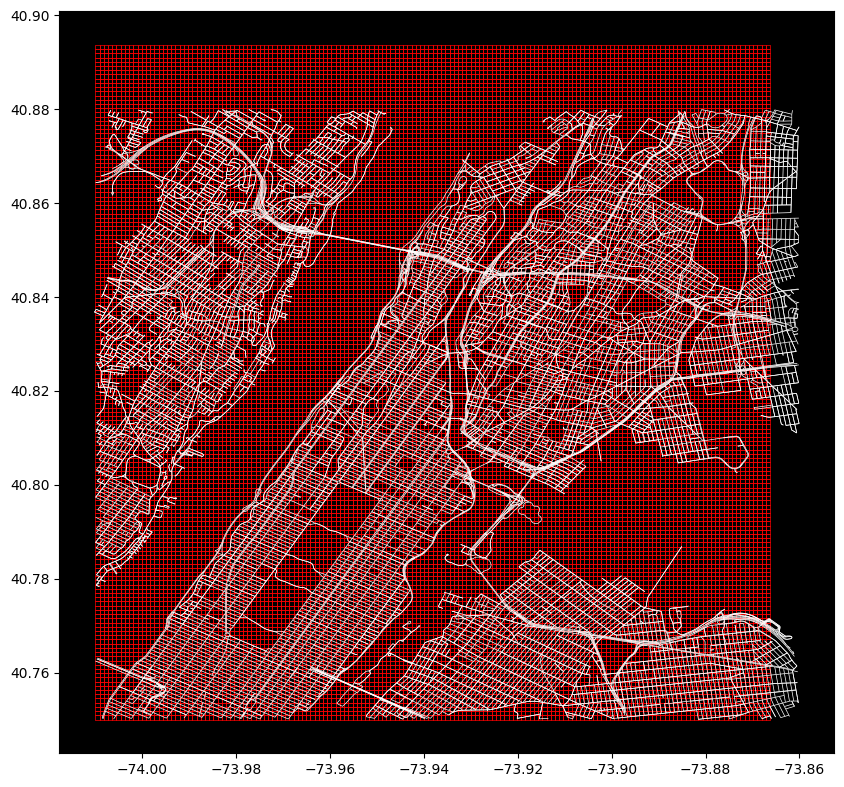

In [29]:
import geopandas as gpd
from shapely.geometry import Polygon
import numpy as np

# G = ox.graph_from_polygon(bbox, network_type='drive')

# Define your grid (example for a 10x10 grid)
grid_size = 100 / 111320   # meters per cell
cols = 160  # number of columns
rows = 160  # number of rows

# Create the bounding box of the area to be covered
xmin, ymin, xmax, ymax = COORDS[0], COORDS[1], COORDS[2], COORDS[3]

# Create a list of grid cells (polygons)
grid_cells = []
for i in range(cols):
    for j in range(rows):
        x1 = xmin + i * grid_size
        y1 = ymin + j * grid_size
        x2 = x1 + grid_size
        y2 = y1 + grid_size
        grid_cells.append(Polygon([(x1, y1), (x2, y1), (x2, y2), (x1, y2)]))

# Convert grid to GeoDataFrame
grid_gdf = gpd.GeoDataFrame(geometry=grid_cells)

nodes, edges = ox.graph_to_gdfs(G)

# Create the figure and axis
fig, ax = plt.subplots(figsize=(10, 10))

# Plot the edges and nodes
edges.plot(ax=ax, linewidth=0.5, edgecolor='w')
nodes.plot(ax=ax, markersize=0, color='r')  # You can adjust marker size or color as needed

# Customize the background color
ax.set_facecolor('black')

# Plot the street network and the grid
# fig, ax = plt.subplots(figsize=(10, 10))
# ox.plot_graph(G, ax=ax, bgcolor='k', node_size=0, edge_color='w', edge_linewidth=0.5)
# ox.plot_graph(G, figsize=(10, 10), bgcolor='k', node_size=0, edge_color='w', edge_linewidth=0.5)
grid_gdf.plot(ax=ax, facecolor='none', edgecolor='r', linewidth=0.5)
plt.show()


In [14]:
import boto3
from botocore import UNSIGNED
from botocore.config import Config

# Create an S3 client with unsigned access
s3 = boto3.client("s3", config=Config(signature_version=UNSIGNED))

# Define bucket name and prefix (path inside the bucket)
bucket_name = "dataforgood-fb-data"
prefix = "forests/v1/alsgedi_global_v6_float/msk"

# List files
target_filename = "032010110.tif.msk"

# List files
response = s3.list_objects_v2(Bucket=bucket_name, Prefix=prefix)

# Check for files and find the specific one
if "Contents" in response:
    found_files = []
    for obj in response["Contents"]:
        # Check if the target file name is part of the key (path + filename)
        if target_filename in obj["Key"]:
            found_files.append(obj["Key"])
    
    if found_files:
        print(f"Found the following file(s):")
        for file in found_files:
            print(file)
    else:
        print(f"No file named '{target_filename}' found.")
else:
    print("No files found.")

No file named '032010110.tif.msk' found.


In [ ]:
import os
import osmnx as ox
import geopandas as gpd
import numpy as np
import pandas as pd
from shapely.geometry import box
from shapely.ops import unary_union
from rasterio.transform import from_origin
import rasterio
from tqdm import tqdm
from collections import Counter
from scipy.stats import entropy

# --- 1. Define bounding box (example: Taipei) ---
bbox_coords = COORDS  # [west, south, east, north]
polygon = box(*bbox_coords)

# --- 2. Download full network once ---
G = ox.graph_from_polygon(polygon, network_type='drive')

# --- 3. Project graph (choose EPSG for your region) ---
G_proj = ox.project_graph(G, to_crs="EPSG:26918")  # Taiwan EPSG:3826 (meters)

# --- 4. Convert to GeoDataFrames ---
nodes, edges = ox.graph_to_gdfs(G_proj)

# --- 5. Create 30m x 30m grid ---
bounds = edges.total_bounds
xmin, ymin, xmax, ymax = bounds
grid_size = 1000 / 111320
cols = int((xmax - xmin) // grid_size)
rows = int((ymax - ymin) // grid_size)

grid_cells = []
for i in range(cols):
    for j in range(rows):
        cell = box(
            xmin + i * grid_size,
            ymin + j * grid_size,
            xmin + (i + 1) * grid_size,
            ymin + (j + 1) * grid_size
        )
        grid_cells.append(cell)

grid = gpd.GeoDataFrame({'geometry': grid_cells}, crs=edges.crs)

# --- 6. Initialize arrays for each metric ---
metrics = {
    'n': np.full((rows, cols), np.nan),
    'm': np.full((rows, cols), np.nan),
    'k_avg': np.full((rows, cols), np.nan),
    'edge_length_total': np.full((rows, cols), np.nan),
    'edge_length_avg': np.full((rows, cols), np.nan),
    'streets_per_node_avg': np.full((rows, cols), np.nan),
    'streets_per_node_counts': np.zeros((rows, cols, 9)),  # 9 bins for streets per node counts (0-8)
    'streets_per_node_proportions': np.zeros((rows, cols, 9)),  # 9 bins for streets per node proportions
    'intersection_count': np.full((rows, cols), np.nan),
    'street_length_total': np.full((rows, cols), np.nan),
    'street_length_avg': np.full((rows, cols), np.nan),
    'street_segment_count': np.full((rows, cols), np.nan),
    'self_loop_proportion': np.full((rows, cols), np.nan),
}

# --- 7. Function to calculate orientation entropy ---
def calc_orientation_entropy(edges_clip):
    if len(edges_clip) == 0:
        return np.nan
    bearings = ox.bearing.calculate_bearings(edges_clip)
    bin_counts = Counter((bearings // 10 * 10).astype(int))  # bin every 10 degrees
    probs = np.array(list(bin_counts.values())) / sum(bin_counts.values())
    return entropy(probs)

# --- 8. Loop over grid cells and compute stats ---
# for idx, cell in tqdm(enumerate(grid.geometry), total=len(grid)):
#     col = idx % cols
#     row = idx // cols

#     try:
#         nodes_clip = nodes[nodes.geometry.within(cell)]
#         edges_clip = edges[edges.geometry.intersects(cell)]

#         if len(nodes_clip) > 1 and len(edges_clip) > 0:
#             G_sub = ox.utils_graph.graph_from_gdfs(nodes_clip, edges_clip)
#             stats = ox.basic_stats(G_sub, clean_int_tol=15)

#             area_km2 = (grid_size ** 2) / 1e6

#             # Fill metrics arrays
#             metrics['n'][row, col] = len(nodes_clip)
#             metrics['m'][row, col] = len(edges_clip)
#             metrics['k_avg'][row, col] = stats['k_avg']
#             metrics['edge_length_total'][row, col] = stats['edge_length_total'] * 111320
#             metrics['edge_length_avg'][row, col] = stats['edge_length_avg'] * 111320
#             metrics['streets_per_node_avg'][row, col] = stats['streets_per_node_avg']
#             metrics['intersection_count'][row, col] = stats['intersection_count']
#             metrics['street_length_total'][row, col] = stats['street_length_total'] * 111320
#             metrics['street_length_avg'][row, col] = stats['street_length_avg'] * 111320
#             metrics['street_segment_count'][row, col] = stats['street_segment_count']
#             metrics['self_loop_proportion'][row, col] = stats['self_loop_proportion']

#             # Streets per node counts and proportions
#             spnc = stats['streets_per_node_counts']
#             snpp = stats['streets_per_node_proportions']

#             for i in range(9):  # Update counts and proportions (0-8 streets per node)
#                 metrics['streets_per_node_counts'][row, col, i] = spnc.get(i, 0)
#                 metrics['streets_per_node_proportions'][row, col, i] = snpp.get(i, 0)

#     except Exception as e:
#         continue  # skip problematic cells

# # --- 9. Define raster transform ---
# transform = from_origin(xmin, ymax, grid_size, grid_size)


In [ ]:
import ijson
readfile = "../data_pipeline/data/raw/traffic.json"
features = []
with open(readfile, "r", encoding="utf-8") as f:
    for feature in ijson.items(f, "item"): 
        features.append(feature)
print("Load data sucessfully!")

df = gpd.GeoDataFrame(features)



Load data sucessfully!


In [42]:
np.nanmean([np.nan, np.nan])

nan

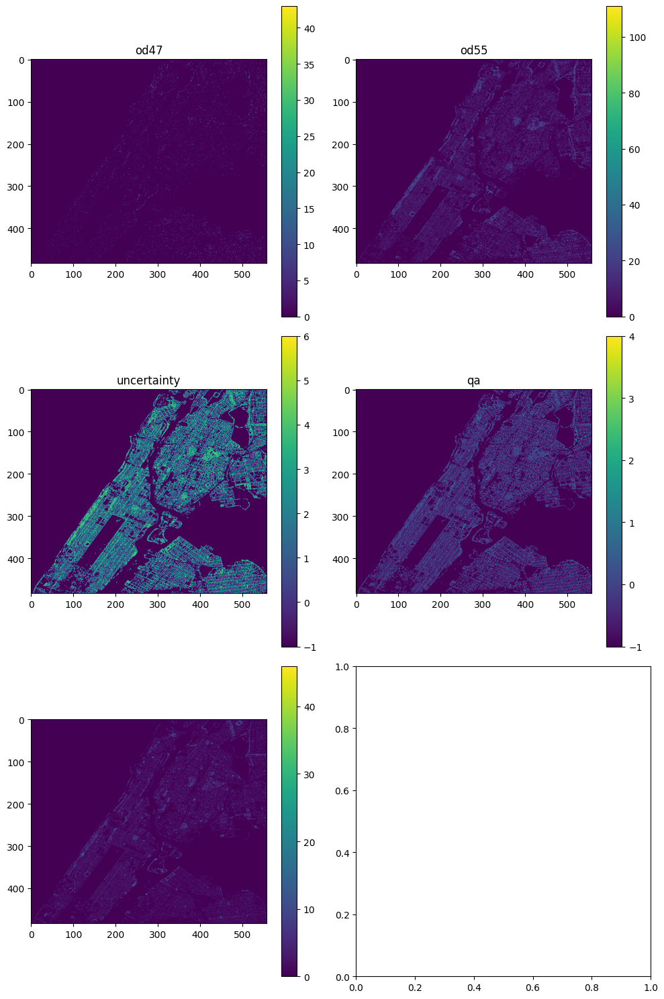

In [70]:
# Reads and plots four bands (B04, B08, B06, B01) from the GeoTIFF file.

# Open the GeoTIFF file
tiff_path = "../data_pipeline/data/tiff/1x1/tree_points_res30.tiff"

# Read the bands from the GeoTIFF file
with rasterio.open(tiff_path) as dst:
    band1 = dst.read(1)
    band2 = dst.read(2)
    band3 = dst.read(3)
    band4 = dst.read(4)
    band5 = dst.read(5)
    # band6 = dst.read(6)

band_name = ['od47', 'od55', 'uncertainty', 'qa', '', ''] 
band_lst = [band1
            , band2, 
            band3, band4, band5, 
            # band6
            ]
fig, axes = plt.subplots(3, 2, figsize=(10, 15))

# Flatten the axes for easier indexing
axes = axes.flatten()

for i in range(len(band_lst)):
    im = axes[i].imshow(band_lst[i], cmap='viridis')
    axes[i].set_title(band_name[i])
    fig.colorbar(im, ax=axes[i])

plt.tight_layout()
plt.show()


In [111]:
band2

array([[  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0, 329],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0, 327],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0, 322],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0, 334, 330],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0, 323],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
        382, 382, 341, 328],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         

In [ ]:
def decode_aod_qa(value):
    """Decodes a 16-bit AOD_QA bitmask value."""
    
    # Extract different bit groups
    cloud_mask = (value >> 0) & 0b111       # Bits 0-2
    land_water_snow_mask = (value >> 3) & 0b11  # Bits 3-4
    adjacency_mask = (value >> 5) & 0b111  # Bits 5-7
    aod_qa = (value >> 8) & 0b1111         # Bits 8-11
    glint_mask = (value >> 12) & 0b1       # Bit 12
    aerosol_model = (value >> 13) & 0b11   # Bits 13-14
    reserved = (value >> 15) & 0b1         # Bit 15

    # Define lookup tables
    cloud_mask_dict = {
        0: "Undefined",
        1: "Clear",
        2: "Possibly cloudy (AOD filter)",
        3: "Cloudy (cloud mask algorithm)",
        5: "Cloud shadow",
        6: "Hot spot of fire",
        7: "Water sediments"
    }

    land_water_snow_dict = {
        0: "Land",
        1: "Water",
        2: "Snow",
        3: "Ice"
    }

    adjacency_dict = {
        0: "Normal condition / Clear",
        1: "Adjacent to clouds",
        2: "Surrounded by more than 4 cloudy pixels",
        3: "Adjacent to a single cloudy pixel",
        4: "Adjacent to snow",
        5: "Snow was previously detected"
    }

    aod_qa_dict = {
        0: "Best quality",
        1: "Water sediments detected",
        3: "1 neighbor cloud",
        4: ">1 neighbor clouds",
        5: "No retrieval (cloudy, etc.)",
        6: "No retrieval near snow",
        7: "Climatology AOD (high altitude)",
        8: "No retrieval (sun glint)",
        9: "AOD very low (<0.05) due to glint",
        10: "AOD replaced near coastline",
        11: "Land, research quality"
    }

    aerosol_model_dict = {
        0: "Background model (regional)",
        1: "Smoke model (regional)",
        2: "Dust model"
    }

    # Decode values
    result = {
        "Cloud Mask": cloud_mask_dict.get(cloud_mask, "Unknown"),
        "Land/Water/Snow": land_water_snow_dict.get(land_water_snow_mask, "Unknown"),
        "Adjacency Mask": adjacency_dict.get(adjacency_mask, "Unknown"),
        "AOD QA": aod_qa_dict.get(aod_qa, "Unknown"),
        "Glint Mask": "Glint detected" if glint_mask else "No glint",
        "Aerosol Model": aerosol_model_dict.get(aerosol_model, "Unknown"),
        "Reserved": "Future use" if reserved else "Not used"
    }

    return result

# Example usage:
aod_qa_values = [1, 865, 1057, 0]
for value in aod_qa_values:
    print(f"AOD_QA Value: {value} -> {bin(value)[2:].zfill(16)}")
    decoded = decode_aod_qa(value)
    for key, desc in decoded.items():
        print(f"  {key}: {desc}")
    print()


AOD_QA Value: 1 -> 0000000000000001
  Cloud Mask: Clear
  Land/Water/Snow: Land
  Adjacency Mask: Normal condition / Clear
  AOD QA: Best quality
  Glint Mask: No glint
  Aerosol Model: Background model (regional)
  Reserved: Not used

AOD_QA Value: 865 -> 0000001101100001
  Cloud Mask: Clear
  Land/Water/Snow: Land
  Adjacency Mask: Adjacent to a single cloudy pixel
  AOD QA: 1 neighbor cloud
  Glint Mask: No glint
  Aerosol Model: Background model (regional)
  Reserved: Not used

AOD_QA Value: 1057 -> 0000010000100001
  Cloud Mask: Clear
  Land/Water/Snow: Land
  Adjacency Mask: Adjacent to clouds
  AOD QA: >1 neighbor clouds
  Glint Mask: No glint
  Aerosol Model: Background model (regional)
  Reserved: Not used

AOD_QA Value: 0 -> 0000000000000000
  Cloud Mask: Undefined
  Land/Water/Snow: Land
  Adjacency Mask: Normal condition / Clear
  AOD QA: Best quality
  Glint Mask: No glint
  Aerosol Model: Background model (regional)
  Reserved: Not used



In [106]:
def check_band_zero(tiff_folder, band_index=4):
    """
    Reads all TIFF files in a folder and checks if all values in a given band are zero.
    
    Args:
        tiff_folder (str): Path to the folder containing TIFF files.
        band_index (int): Band index to check (1-based index).
    
    Returns:
        dict: Dictionary where keys are filenames and values are True (all zeros) or False.
    """
    
    # Loop through all TIFF files in the folder
    count = 0
    for filename in os.listdir(tiff_folder):
        if filename.endswith(".tif") or filename.endswith(".tiff"):
            file_path = os.path.join(tiff_folder, filename)
            
            with rasterio.open(file_path) as dataset:
                band = dataset.read(4)  # Read the specified band
                
            aod_qa_bits = np.bitwise_and(np.right_shift(band, 8), 0b1111)
            if np.all(np.isin(aod_qa_bits, [0, 3 ,4])):
                count += 1
    
    return count

In [107]:
folder = "../data_pipeline/data/raw/air_quality/AOD/"
check_band_zero(folder, 4)

89

In [120]:
mask = aod_qa_bits == 3

In [128]:
band4 = band4.astype('float')

In [129]:
band4[mask] = np.nan

In [130]:
band4

array([[0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,       nan],
       [0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00],
       [0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00],
       [0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00],
       [0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
    

In [110]:
aod_qa_bits = np.bitwise_and(np.right_shift(band4, 8), 0b1111)
aod_qa_bits

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 3, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3]], dtype=int32)

In [82]:
file = "../data_pipeline/data/raw/AADT_2021.gdb/a00000007.gdbtable"
df1 = gpd.read_file(file)
df1.head()

,UUID,OrigItemTypeID,DestItemTypeID,Name,ForwardLabel,BackwardLabel,IsContainment
0,{5DD0C1AF-CB3D-4FEA-8C51-CB3BA8D77CDB},{F3783E6F-65CA-4514-8315-CE3985DAD3B1},{8405ADD5-8DF8-4227-8FAC-3FCADE073386},ItemInFolder,Contains Item,Contained In Folder,1
1,{5F9085E0-788F-4354-AE3C-34C83A7EA784},{A3803369-5FC2-4963-BAE0-13EFFC09DD73},{CD06BC3B-789D-4C51-AAFA-A467912B8965},TableInParcelFabric,Manages Table,Participates In Parcel Fabric,0
2,{725BADAB-3452-491B-A795-55F32D67229C},{28DA9E89-FF80-4D6D-8926-4EE2B161677D},{28DA9E89-FF80-4D6D-8926-4EE2B161677D},DatasetsRelatedThrough,Origin Of,Destination Of,0
3,{E79B44E3-F833-4B12-90A1-364EC4DDC43E},{70737809-852C-4A03-9E22-2CECEA5B9BFA},{A300008D-0CEA-4F6A-9DFA-46AF829A3DF2},RepresentationOfFeatureClass,Feature Class Representation,Represented Feature Class,0
4,{0D10B3A7-2F64-45E6-B7AC-2FC27BF2133C},{F3783E6F-65CA-4514-8315-CE3985DAD3B1},{F3783E6F-65CA-4514-8315-CE3985DAD3B1},FolderInFolder,Parent Folder Of,Child Folder Of,1


In [29]:
data = df.loc[df['boro'].isin(['Manhattan', 'Bronx']) & (df['yr'] == '2021') & (df['m'] == '7') & (df['hh'].isin(['15', '16'])), :]

In [32]:
data

,requestid,boro,yr,m,d,hh,mm,vol,segmentid,wktgeom,street,fromst,tost,direction
33493,34023,Manhattan,2021,7,12,15,0,63,38484,POINT (996446.8857448514 233920.51304525515),MORNINGSIDE AVENUE,West 120 Street,West 121 Street,NB
33494,34023,Manhattan,2021,7,12,15,15,57,38484,POINT (996446.8857448514 233920.51304525515),MORNINGSIDE AVENUE,West 120 Street,West 121 Street,NB
33495,34023,Manhattan,2021,7,12,15,30,71,38484,POINT (996446.8857448514 233920.51304525515),MORNINGSIDE AVENUE,West 120 Street,West 121 Street,NB
33496,34023,Manhattan,2021,7,12,15,45,69,38484,POINT (996446.8857448514 233920.51304525515),MORNINGSIDE AVENUE,West 120 Street,West 121 Street,NB
33497,34023,Manhattan,2021,7,12,16,0,75,38484,POINT (996446.8857448514 233920.51304525515),MORNINGSIDE AVENUE,West 120 Street,West 121 Street,NB
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1652940,33539,Manhattan,2021,7,19,15,45,65,229580,POINT (988560.7694578806 212251.00973740162),WEST 35 STREET,5 Avenue,Dead end,WB
1652941,33539,Manhattan,2021,7,19,16,0,76,229580,POINT (988560.7694578806 212251.00973740162),WEST 35 STREET,5 Avenue,Dead end,WB
1652942,33539,Manhattan,2021,7,19,16,15,85,229580,POINT (988560.7694578806 212251.00973740162),WEST 35 STREET,5 Avenue,Dead end,WB
1652943,33539,Manhattan,2021,7,19,16,30,87,229580,POINT (988560.7694578806 212251.00973740162),WEST 35 STREET,5 Avenue,Dead end,WB


In [58]:
readfile = "../data_pipeline/data/preprocessed/street.geojson"
# features = []
# with open(readfile, "r", encoding="utf-8") as f:
#     for feature in ijson.items(f, "item"): 
#         features.append(feature)
# print("Load data sucessfully!")

street_gdf = gpd.read_file(readfile)

In [59]:
data['segmentid'] = data['segmentid'].astype('int')
street_gdf['SegmentID'] = street_gdf['SegmentID'].astype('float').astype('int')

In [52]:
data['segmentid'].dtype

dtype('int32')

In [63]:
data['street'].unique()

array(['MORNINGSIDE AVENUE', 'WEST 121 STREET', '5 AVENUE',
       'EAST 36 STREET', 'REVERE AVENUE', 'WEST 35 STREET',
       'WEST 59 STREET', 'ANDERSON AVENUE', 'JACKSON AVENUE',
       'MORRIS PARK AVENUE'], dtype=object)

In [ ]:
data.merge(street_gdf[['SegmentID', 'Street', 'geometry']], left_on='segmentid', right_on='SegmentID', how='left')

,requestid,boro,yr,m,d,hh,mm,vol,segmentid,wktgeom,street,fromst,tost,direction,SegmentID,Street,geometry
0,34023,Manhattan,2021,7,12,15,0,63,38484,POINT (996446.8857448514 233920.51304525515),MORNINGSIDE AVENUE,West 120 Street,West 121 Street,NB,38484.0,MORNINGSIDE AVENUE,"LINESTRING (-73.95635 40.80818, -73.95589 40.8..."
1,34023,Manhattan,2021,7,12,15,0,63,38484,POINT (996446.8857448514 233920.51304525515),MORNINGSIDE AVENUE,West 120 Street,West 121 Street,NB,38484.0,MORNINGSIDE AVENUE,"LINESTRING (-73.95635 40.80818, -73.95589 40.8..."
2,34023,Manhattan,2021,7,12,15,15,57,38484,POINT (996446.8857448514 233920.51304525515),MORNINGSIDE AVENUE,West 120 Street,West 121 Street,NB,38484.0,MORNINGSIDE AVENUE,"LINESTRING (-73.95635 40.80818, -73.95589 40.8..."
3,34023,Manhattan,2021,7,12,15,15,57,38484,POINT (996446.8857448514 233920.51304525515),MORNINGSIDE AVENUE,West 120 Street,West 121 Street,NB,38484.0,MORNINGSIDE AVENUE,"LINESTRING (-73.95635 40.80818, -73.95589 40.8..."
4,34023,Manhattan,2021,7,12,15,30,71,38484,POINT (996446.8857448514 233920.51304525515),MORNINGSIDE AVENUE,West 120 Street,West 121 Street,NB,38484.0,MORNINGSIDE AVENUE,"LINESTRING (-73.95635 40.80818, -73.95589 40.8..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
579,33539,Manhattan,2021,7,19,16,30,87,229580,POINT (988560.7694578806 212251.00973740162),WEST 35 STREET,5 Avenue,Dead end,WB,229580.0,WEST 35 STREET,"LINESTRING (-73.98408 40.74911, -73.98715 40.7..."
580,33539,Manhattan,2021,7,19,16,30,87,229580,POINT (988560.7694578806 212251.00973740162),WEST 35 STREET,5 Avenue,Dead end,WB,229580.0,WEST 35 STREET,"LINESTRING (-73.98408 40.74911, -73.98715 40.7..."
581,33539,Manhattan,2021,7,19,16,45,82,229580,POINT (988560.7694578806 212251.00973740162),WEST 35 STREET,5 Avenue,Dead end,WB,229580.0,WEST 35 STREET,"LINESTRING (-73.98408 40.74911, -73.98715 40.7..."
582,33539,Manhattan,2021,7,19,16,45,82,229580,POINT (988560.7694578806 212251.00973740162),WEST 35 STREET,5 Avenue,Dead end,WB,229580.0,WEST 35 STREET,"LINESTRING (-73.98408 40.74911, -73.98715 40.7..."


In [42]:
for col in street_gdf.columns:
    print(col)

OBJECTID
Street
SAFStreetName
FeatureTyp
SegmentTyp
IncExFlag
RB_Layer
NonPed
TrafDir
TrafSrc
SpecAddr
FaceCode
SeqNum
StreetCode
SAFStreetCode
LGC1
LGC2
LGC3
LGC4
LGC5
LGC6
LGC7
LGC8
LGC9
BOE_LGC
SegmentID
SegCount
LocStatus
LZip
RZip
LBoro
RBoro
L_CD
R_CD
LATOMICPOLYGON
RATOMICPOLYGON
LCT2020
LCT2020Suf
RCT2020
RCT2020Suf
LCB2020
LCB2020Suf
RCB2020
RCB2020Suf
LCT2010
LCT2010Suf
RCT2010
RCT2010Suf
LCB2010
LCB2010Suf
RCB2010
RCB2010Suf
LCT2000
LCT2000Suf
RCT2000
RCT2000Suf
LCB2000
LCB2000Suf
RCB2000
RCB2000Suf
LCT1990
LCT1990Suf
RCT1990
RCT1990Suf
LAssmDist
LElectDist
RAssmDist
RElectDist
SplitElect
LSchlDist
RSchlDist
SplitSchl
LSubSect
RSubSect
SanDistInd
MapFrom
MapTo
BoroBndry
MH_RI_Flag
XFrom
YFrom
XTo
YTo
ArcCenterX
ArcCenterY
CurveFlag
Radius
NodeIDFrom
NodeIDTo
NodeLevelF
NodeLevelT
ConParity
Twisted
RW_TYPE
PhysicalID
GenericID
NYPDID
FDNYID
LBlockFaceID
RBlockFaceID
LegacyID
Status
StreetWidth_Min
StreetWidth_Max
StreetWidth_Irr
BikeLane
BIKE_TRAFDIR
ACTIVE_FLAG
POSTED_SPEED


In [ ]:
import rioxarray

tiff_path = "../data_pipeline/data/araw/GHS_POP_E2020_GLOBE_R2023A_4326_3ss_V1_0_R5_C11/GHS_POP_E2020_GLOBE_R2023A_4326_3ss_V1_0_R5_C11.tif"
population = rioxarray.open_rasterio(tiff_path, masked=True)
population

<xarray.DataArray (band: 1, y: 12000, x: 12000)> Size: 1GB
[144000000 values with dtype=float64]
Coordinates:
  * band         (band) int32 4B 1
  * x            (x) float64 96kB -80.01 -80.01 -80.01 ... -70.01 -70.01 -70.01
  * y            (y) float64 96kB 49.1 49.1 49.1 49.1 ... 39.1 39.1 39.1 39.1
    spatial_ref  int32 4B 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0

In [76]:
population.rio.crs

CRS.from_wkt('GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84",6378137,298.257223563,AUTHORITY["EPSG","7030"]],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0,AUTHORITY["EPSG","8901"]],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AXIS["Latitude",NORTH],AXIS["Longitude",EAST],AUTHORITY["EPSG","4326"]]')

In [5]:
import rasterio
from rasterio.mask import mask
import geopandas as gpd
from shapely.geometry import box

# Define the bounding box (minx, miny, maxx, maxy)
bbox = (-74.01, 40.75, -73.86, 40.88)

# Create a Polygon (bounding box) using Shapely
bbox_geom = box(bbox[0], bbox[1], bbox[2], bbox[3])

# Load the shapely geometry into GeoDataFrame for masking
gdf = gpd.GeoDataFrame({"geometry": [bbox_geom]}, crs="EPSG:4326")  # Assuming your CRS is EPSG:4326

# Open the TIFF file
with rasterio.open(tiff_path) as src:
    # Reproject the GeoDataFrame to match the TIFF's CRS
    gdf = gdf.to_crs(src.crs)
    
    # Mask the image using the bounding box
    out_image, out_transform = mask(src, gdf.geometry, crop=True)

In [6]:
def filter_population_tiff(pop_file, savefile):
    # Create a Polygon (bounding box) using Shapely
    bbox_geom = box(-74.01, 40.75, -73.86, 40.88)

    # Load the shapely geometry into GeoDataFrame for masking
    gdf = gpd.GeoDataFrame({"geometry": [bbox_geom]}, crs="EPSG:4326")

    # Open the TIFF file
    with rasterio.open(pop_file) as src:
        gdf = gdf.to_crs(src.crs)
        out_image, out_transform = mask(src, gdf.geometry, crop=True)
        out_image = out_image.squeeze()

    # # Save the clipped image to a new file
    with rasterio.open(savefile, 'w', driver='GTiff', count=1, crs=gdf.crs,
                       dtype=out_image.dtype,
                       height=out_image.shape[0], width=out_image.shape[1]) as dst:
        dst.write(out_image, 1)
        # dst.transform = out_transform

pop_file = "GHS_POP_E2020_GLOBE_R2023A_4326_3ss_V1_0_R5_C11/GHS_POP_E2020_GLOBE_R2023A_4326_3ss_V1_0_R5_C11.tif"
filter_population_tiff(tiff_path, "../data_pipeline/data/tiff/population_res100.tiff")

In [11]:
savefile = "../data_pipeline/data/tiff/population_res100.tiff"
bbox_geom = box(-74.01, 40.75, -73.86, 40.88)

# Load the shapely geometry into GeoDataFrame for masking
gdf = gpd.GeoDataFrame({"geometry": [bbox_geom]}, crs="EPSG:4326")

# Open the TIFF file
with rasterio.open(tiff_path) as src:
    gdf = gdf.to_crs(src.crs)
    out_image, out_transform = mask(src, gdf.geometry, crop=True)
    out_image = out_image.squeeze()

# # Save the clipped image to a new file
with rasterio.open(savefile, 'w', driver='GTiff', count=1, crs=gdf.crs,
                    dtype=out_image.dtype,
                    height=out_image.shape[0], width=out_image.shape[1]) as dst:
    print("writing file")
    dst.write(out_image, 1)

writing file


In [ ]:
with rasterio.open(savefile, 'w', driver='GTiff', count=7, crs=df.crs,
                       dtype=zonedist_level1.dtype,
                       height=height, width=width,
                       transform=gt) as dst:
        dst.write(zonedist_level1, 1)
        dst.write(zonedist_level2, 2)
        dst.write(zonedist_level3, 3)
        dst.write(has_residence, 4)
        dst.write(has_manufacture, 5)
        dst.write(has_commercial, 6)
        dst.write(has_park, 7)


(157, 181)

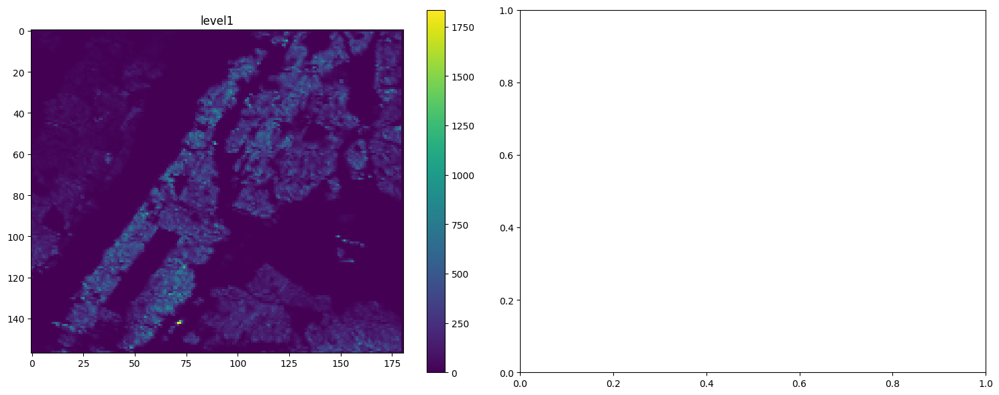

In [13]:
# Reads and plots four bands (B04, B08, B06, B01) from the GeoTIFF file.

# Open the GeoTIFF file
tiff_path = "../data_pipeline/data/tiff/population_res100.tiff"
population = rioxarray.open_rasterio(tiff_path, masked=True)

# Read the bands from the GeoTIFF file
with rasterio.open(tiff_path) as dst:
    # print(dst.descriptions)
    overlay_level1 = dst.read(1)
    # overlay_level2 = dst.read(2)

band_name = ['level1'] 
band_lst = [out_image]
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Flatten the axes for easier indexing
axes = axes.flatten()

for i in range(len(band_lst)):
    im = axes[i].imshow(band_lst[i], cmap='viridis')
    axes[i].set_title(band_name[i])
    fig.colorbar(im, ax=axes[i])

plt.tight_layout()
plt.show()


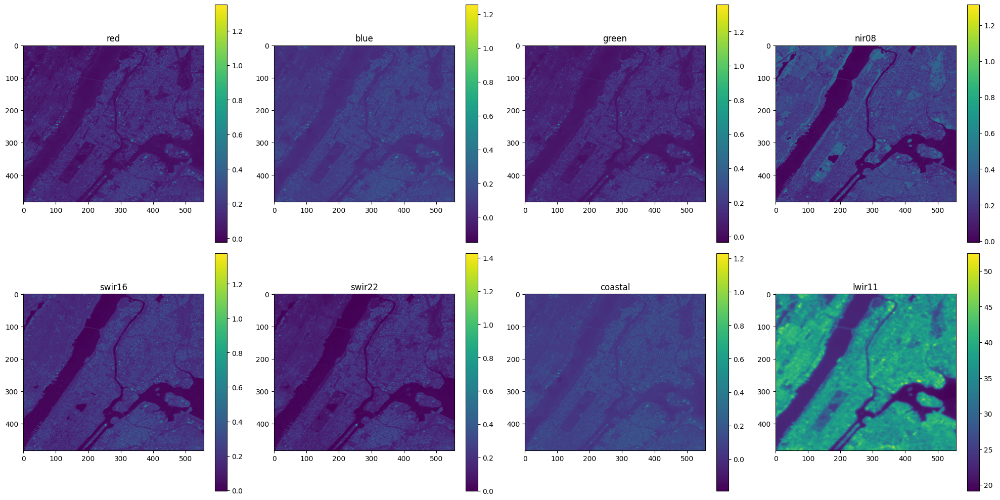

In [ ]:
# Reads and plots four bands (B04, B08, B06, B01) from the GeoTIFF file.

# Open the GeoTIFF file
tiff_path = "data_pipeline/data/tiff/landsat_8.tiff"

# Read the bands from the GeoTIFF file
with rasterio.open(tiff_path) as dst:
    red = dst.read(1)
    blue = dst.read(2)
    green = dst.read(3)
    nir08 = dst.read(4)
    swir16 = dst.read(5)
    swir22 = dst.read(6)
    coastal = dst.read(7) 
    lwir11 = dst.read(8)

band_name = ['red', 'blue', 'green', 'nir08', 'swir16', 'swir22', 'coastal', 'lwir11'] 
band_lst = [red, blue, green, nir08, swir16, swir22, coastal, lwir11]
fig, axes = plt.subplots(2, 4, figsize=(20, 10))

# Flatten the axes for easier indexing
axes = axes.flatten()

for i in range(len(band_lst)):
    im = axes[i].imshow(band_lst[i], cmap='viridis')
    axes[i].set_title(band_name[i])
    fig.colorbar(im, ax=axes[i])

plt.tight_layout()
plt.show()


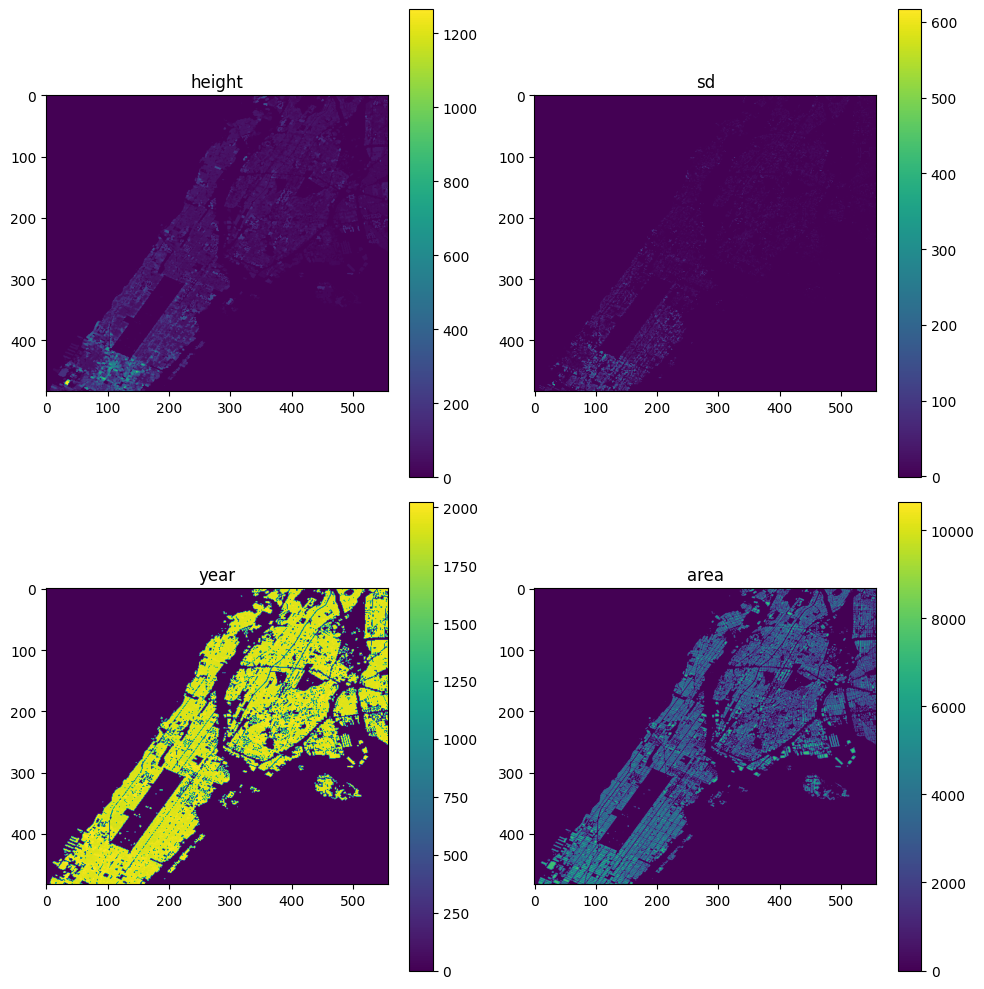

In [ ]:
# Reads and plots four bands (B04, B08, B06, B01) from the GeoTIFF file.

# Open the GeoTIFF file
tiff_path = "data_pipeline/data/tiff/building_res30.tiff"

# Read the bands from the GeoTIFF file
with rasterio.open(tiff_path) as dst:
    building_height = dst.read(1)
    building_sd = dst.read(2)
    building_year = dst.read(3)
    building_area = dst.read(4)

band_name = ['height', 'sd', 'year', 'area']
band_lst = [building_height, building_sd, building_year, building_area]
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

# Flatten the axes for easier indexing
axes = axes.flatten()

for i in range(len(band_lst)):
    im = axes[i].imshow(band_lst[i], cmap='viridis')
    axes[i].set_title(band_name[i])
    fig.colorbar(im, ax=axes[i])

plt.tight_layout()
plt.show()


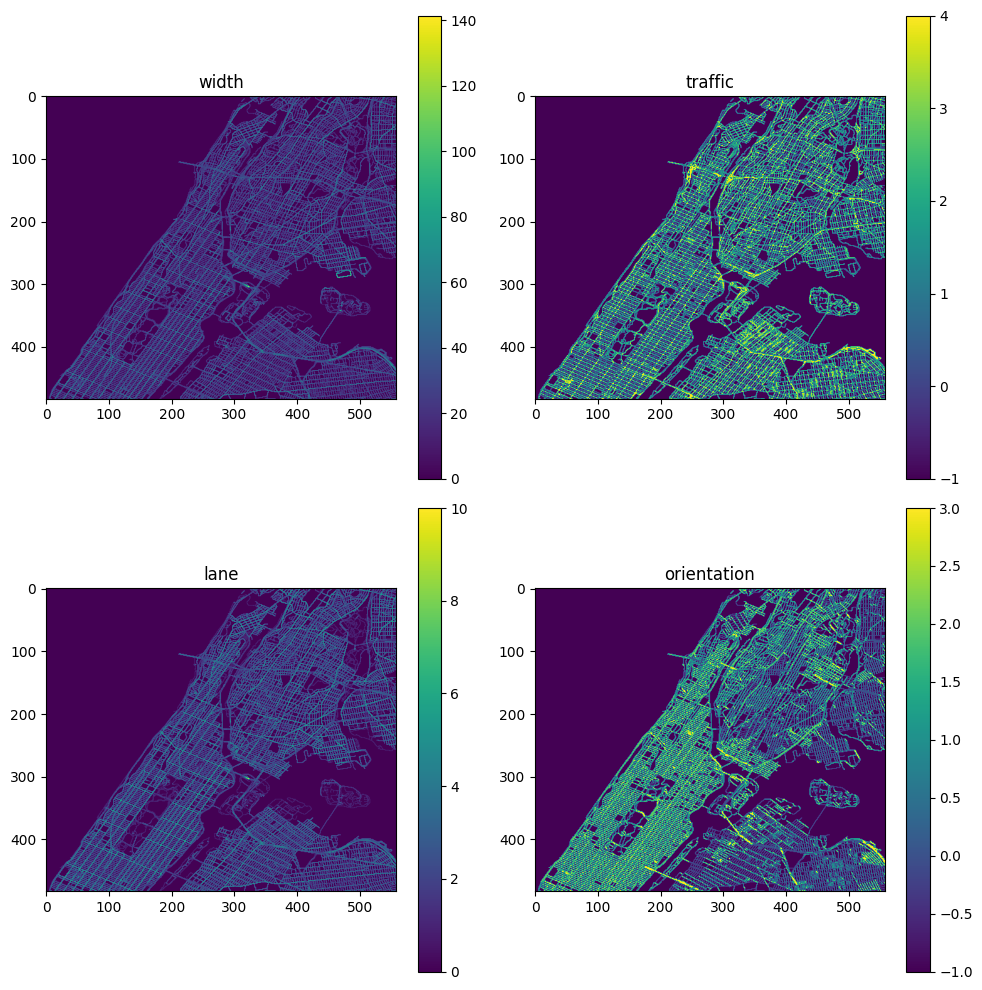

In [ ]:
# Reads and plots four bands (B04, B08, B06, B01) from the GeoTIFF file.

# Open the GeoTIFF file
tiff_path = "data_pipeline/data/tiff/street_res30.tiff"

# Read the bands from the GeoTIFF file
with rasterio.open(tiff_path) as dst:
    street_width = dst.read(1)
    traffic_dir = dst.read(2)
    street_lane = dst.read(3)
    orientation = dst.read(4)
    bounds = dst.bounds
    
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

band_lst = [street_width, traffic_dir, street_lane, orientation]
band_name = ['width', 'traffic', 'lane', 'orientation']
# Flatten the axes for easier indexing
axes = axes.flatten()

for i in range(len(band_lst)):
    im = axes[i].imshow(band_lst[i], cmap='viridis')
    axes[i].set_title(band_name[i])
    fig.colorbar(im, ax=axes[i])

plt.tight_layout()
plt.show()


## Plotting

### Response

In [ ]:
import branca.colormap as cm
# Create map
#  [-74.01, 40.75, -73.86, 40.88]
m = folium.Map(location=[40.8, -73.5], zoom_start=7)

colormap = cm.LinearColormap(["green", "yellow", "red"], vmin=ground_df["UHI Index"].min(), vmax=ground_df["UHI Index"].max())
# Add points
for _, row in ground_df.iterrows():
    folium.CircleMarker(
        location=[row["Latitude"], row["Longitude"]],
        radius=1,
        color=colormap(row["UHI Index"]), 
        fill=True,
        fill_opacity=0.7,
    ).add_to(m)

colormap.add_to(m)

m

### Predictors

In [ ]:
# Extracts satellite band values from a GeoTIFF based on coordinates from a csv file and returns them in a DataFrame.

def map_satellite_data(tiff_path, csv_path, col_name):
    
    # Load the GeoTIFF data
    data = rxr.open_rasterio(tiff_path)
    layer_num = 0
    with rasterio.open(tiff_path) as dts:
        layer_num = dts.count

    # Read the Excel file using pandas
    df = pd.read_csv(csv_path)
    latitudes = df['Latitude'].values
    longitudes = df['Longitude'].values   

    df = pd.DataFrame()
    for i in tqdm(range(layer_num), desc="Go through layer"):
        values = []
        # Iterate over the latitudes and longitudes, and extract the corresponding band values
        for lat, lon in tqdm(zip(latitudes, longitudes), total=len(latitudes), desc="Mapping values"):
        # Assuming the correct dimensions are 'y' and 'x' (replace these with actual names from data.coords)
            cell_value = data.sel(x=lon, y=lat,  band=i+1, method="nearest").values
            values.append(cell_value)
        # Add column of feature
        df[col_name[i]] = values
    
    return df


In [ ]:
# Mapping satellite data with training data.
data_dir = "data_pipeline/data/tiff/"
landsat_bands = ['red', 'blue', 'green', 'nir08', 'swir16', 'swir22', 'coastal', 'lwir11']
landsat_data = map_satellite_data(data_dir+'landsat_8.tiff', 'data/Training_data_uhi_index_UHI2025-v2.csv',
                                landsat_bands)

# Mapping satellite data with training data.
building_bands = ['building_height', 'building_sd', 'building_year', 'building_area']
building_data = map_satellite_data(data_dir+'building_res30.tiff', 'data/Training_data_uhi_index_UHI2025-v2.csv',
                                building_bands)

# Mapping satellite data with training data.
street_bands = ['street_width', 'street_traffic', 'street_lane', 'street_orientation']
street_data = map_satellite_data(data_dir+'street_res30.tiff', 'data/Training_data_uhi_index_UHI2025-v2.csv',
                                street_bands)

df = pd.read_csv('data/Training_data_uhi_index_UHI2025-v2.csv')
df = pd.concat([df, landsat_data, building_data, street_data], axis=1)
df

NameError: name 'map_satellite_data' is not defined

In [ ]:
from src.eda import EDA

df = df.drop(columns=['datetime']).astype('float')
df['street_traffic'] = df['street_traffic'].astype('int').astype('category')
df['street_orientation'] = df['street_orientation'].astype('int').astype('category')

stat_eda = EDA(df)
stat_eda.explore_stats()

,feature,data_type,n_distinct,n_missing,n_negative,n_zeros,count,unique,top,freq,mean,std,min,25%,50%,75%,max
0,Longitude,float64,10109 (90.03%),0 (0.00%),11229 (100.00%),0 (0.00%),11229.0,NaN,NaN,NaN,-73.933927,0.028253,-73.994457,-73.955703,-73.932968,-73.909647,-73.879458
1,Latitude,float64,9992 (88.98%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,40.808800,0.023171,40.758792,40.790905,40.810688,40.824515,40.859497
2,UHI Index,float64,595 (5.30%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,1.000001,0.016238,0.956122,0.988577,1.000237,1.011176,1.046036
3,red,float64,2828 (25.18%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,0.138309,0.052183,0.021512,0.106488,0.136298,0.166272,0.521600
4,blue,float64,2635 (23.47%),0 (0.00%),2 (0.02%),0 (0.00%),11229.0,NaN,NaN,NaN,0.107407,0.041744,-0.027108,0.080968,0.104370,0.128597,0.406045
5,green,float64,2711 (24.14%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,0.130044,0.045130,0.029213,0.101510,0.126177,0.152935,0.471687
6,nir08,float64,2962 (26.38%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,0.224469,0.059472,0.053138,0.183240,0.216735,0.257930,0.532407
7,swir16,float64,2749 (24.48%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,0.200798,0.050345,0.054485,0.167372,0.192123,0.226442,0.633030
8,swir22,float64,2832 (25.22%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,0.167788,0.054411,0.045960,0.131292,0.160855,0.195203,0.778587
9,coastal,float64,2534 (22.57%),0 (0.00%),15 (0.13%),0 (0.00%),11229.0,NaN,NaN,NaN,0.095621,0.037477,-0.036128,0.071947,0.092710,0.114435,0.364713


In [ ]:
# Add features 
nir08 = df['nir08']
red = df['red']
green = df['green']
blue = df["blue"]
swir16 = df["swir16"]    
swir22 = df["swir22"] 

df["ndvi"] = (nir08 - red) / (nir08 + red + 1e-10)
df["evi"] = 2.5 * (nir08 - red) / (nir08 + 6 * red - 7.5 * blue + 1 + 1e-10)
df["savi"] = (nir08 - red) * 1.5 / (nir08 + red + 0.5 + 1e-10)
df["gndvi"] = (nir08 - green) / (nir08 + green + 1e-10)
df["arvi"] = (nir08 - (red - (blue - red))) / (nir08 + (red - (blue - red)) + 1e-10)
df["msavi"] = (2 * nir08 + 1 - np.sqrt((2 * nir08 + 1) ** 2 - 8 * (nir08 - red))) / 2

# Water Indices
df["ndwi"] = (green - nir08) / (green + nir08 + 1e-10)
df["mndwi"] = (green - swir16) / (green + swir16 + 1e-10)
df["awei_nsh"] = 4 * (green - swir16) - (0.25 * nir08 + 2.75 * swir22)
df["awei_sh"] = green + 2.5 * nir08 - 1.5 * (swir16 + swir22) - 0.25 * blue

# Soil and Snow Indices
df["ndsi"] = (green - swir16) / (green + swir16 + 1e-10)
df["nbr"] = (nir08 - swir22) / (nir08 + swir22 + 1e-10)

# Urban Indices
df["ndbi"] = (swir16 - nir08) / (swir16 + nir08 + 1e-10)
df["ui"] = (swir16 - red) / (swir16 + red + 1e-10)
df["ibi"] = (df["ndbi"] - (df["savi"] + df["mndwi"])) / \
                    (df["ndbi"] + (df["savi"] + df["mndwi"]) + 1e-10)

# Thermal & Climate Indices
df["si"] = (swir16 - blue) / (swir16 + blue + 1e-10)

# Albedo
df['albedo'] = (0.356 * df['blue'] + 0.130 * df['red'] + 0.373 * df['nir08'] + 0.085 * df['swir16'] + 0.072 * df['swir22'] - 0.018) / 1.016

# Building variance
df['var'] = df['building_height'] / df['street_width']
df['var'] = np.where(df['var'] == np.inf, np.nan, df['var'])

df.shape

(11229, 37)

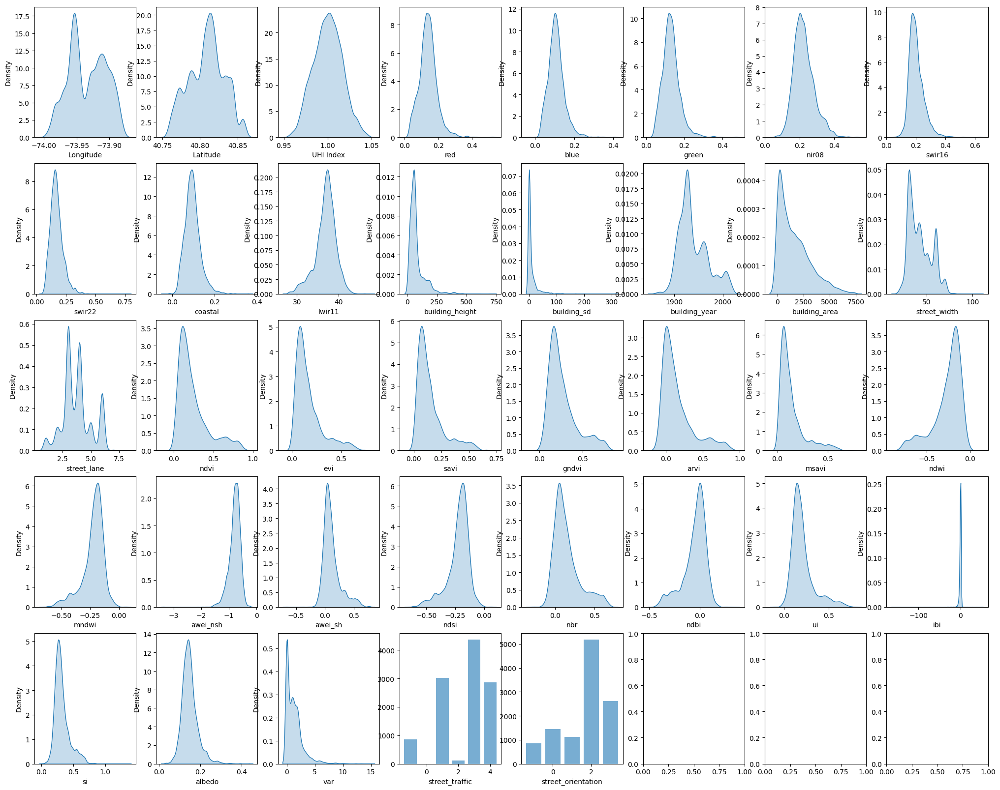

In [ ]:
df_plot = df.copy()

df_plot['building_area'] = np.where(df_plot['building_area'] == 0, np.nan, df_plot['building_area'])
df_plot['building_height'] = np.where(df_plot['building_height'] == 0, np.nan, df_plot['building_height'])
df_plot['building_sd'] = np.where(df_plot['building_sd'] == -1, np.nan, df_plot['building_sd'])
df_plot['building_year'] = np.where(df_plot['building_year'] == 0, np.nan, df_plot['building_year'])
df_plot['street_width'] = np.where(df_plot['street_width'] == 0, np.nan, df_plot['street_width'])
df_plot['street_lane'] = np.where(df_plot['street_lane'] == 0, np.nan, df_plot['street_lane'])

# Identify numerical and categorical columns
num_cols = df_plot.select_dtypes(include=["number"]).columns.tolist()
cat_cols = df_plot.select_dtypes(exclude=["number"]).columns.tolist()

# Create Pair Plot Grid
fig, axes = plt.subplots(5, 8, figsize=(25, 20))
axes = axes.flatten()

# Iterate over all pairs
for i, col in enumerate(num_cols + cat_cols):
    ax = axes[i]

    if col in num_cols:
        sns.kdeplot(df_plot[col], fill=True, ax=ax)
    else:
        counts = df_plot[col].value_counts()
        ax.bar(counts.index, counts.values, alpha=0.6)
    
    ax.set_xlabel(col)

plt.show()

<Axes: >

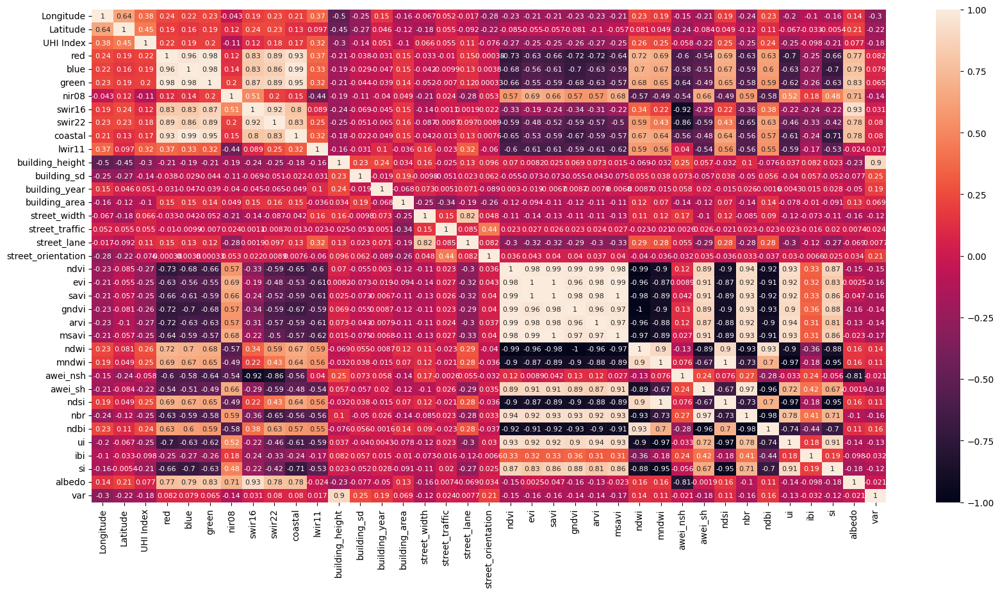

In [ ]:
df_corr = df_plot.corr()

plt.figure(figsize=(20, 10))
sns.heatmap(df_corr, annot=True, annot_kws={"fontsize":8})

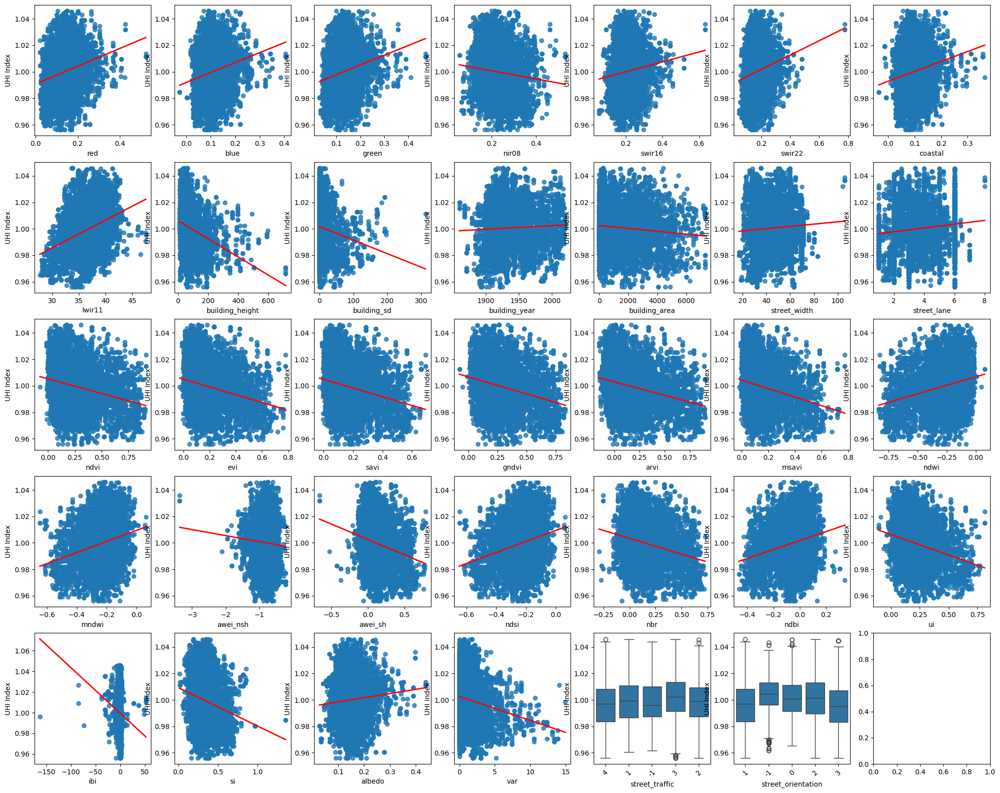

In [ ]:
# Plot relationship with UHI index

# Identify numerical and categorical columns
num_cols = df_plot.drop(columns=['Longitude', 'Latitude', 'UHI Index']).select_dtypes(include=["number"]).columns.tolist()
cat_cols = df_plot.select_dtypes(exclude=["number"]).columns.tolist()

# Create Pair Plot Grid
fig, axes = plt.subplots(5, 7, figsize=(25, 20))
axes = axes.flatten()

# Iterate over all pairs
for i, col in enumerate(num_cols + cat_cols):
    ax = axes[i]

    if col in num_cols:

        sns.regplot(x=col, y="UHI Index", data=df_plot, ax=ax, ci=None, line_kws={'color': 'red', 'linewidth': 2})
    else:
        sns.boxplot(x=df[col], y=df['UHI Index'], ax=ax)
        ax.set_xticklabels(df[col].unique(), rotation=45)
    
    ax.set_xlabel(col)

plt.show()

## Feature engineering

In [ ]:
pd.get_dummies(X_lasso['street_orientation'])

,-1,0,1,2,3
0,False,False,True,False,False
1,False,False,True,False,False
2,False,False,True,False,False
3,False,False,True,False,False
4,False,False,True,False,False
...,...,...,...,...,...
11224,False,False,False,True,False
11225,False,False,False,True,False
11226,False,False,False,True,False
11227,False,False,False,True,False


In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from statsmodels.api import OLS

X_lasso = df.drop(columns=['UHI Index', 'Latitude', 'Longitude'])
X_lasso['var'] = X_lasso['var'].fillna(1000)

orientation = pd.get_dummies(X_lasso['street_orientation'], drop_first=True, prefix='orientation')
traffic = pd.get_dummies(X_lasso['street_traffic'], drop_first=True, prefix='traffic')
X_lasso = pd.concat([X_lasso, orientation, traffic], axis=1)
X_lasso = X_lasso.drop(columns=['street_orientation', 'street_traffic'])


scaler = StandardScaler()
X_lasso_scaled = pd.DataFrame(scaler.fit_transform(X_lasso), columns=X_lasso.columns)

X_lasso_scaled = sm.add_constant(X_lasso_scaled)

y = df['UHI Index']

# Fit LASSO using statsmodels OLS with L1 regularization
model = sm.OLS(y, X_lasso_scaled)
lasso_result = model.fit() 

In [ ]:
print(lasso_result.summary())

                            OLS Regression Results                            
Dep. Variable:              UHI Index   R-squared:                       0.206
Model:                            OLS   Adj. R-squared:                  0.203
Method:                 Least Squares   F-statistic:                     85.25
Date:                Fri, 07 Feb 2025   Prob (F-statistic):               0.00
Time:                        05:02:45   Log-Likelihood:                 31628.
No. Observations:               11229   AIC:                        -6.319e+04
Df Residuals:                   11194   BIC:                        -6.293e+04
Df Model:                          34                                         
Covariance Type:            nonrobust                                         
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               1.0000      0.000   73

In [ ]:
df_pred = df.copy()
df_pred['y_pred'] = lasso_result.predict(X_lasso_scaled)
df_pred['residual'] = y - df_pred['y_pred']

import branca.colormap as cm
# # Create map
# #  [-74.01, 40.75, -73.86, 40.88]
m = folium.Map(location=[40.8, -73.5], zoom_start=7)

colormap = cm.LinearColormap(["green", "yellow", "red"], vmin=df_pred['residual'].min(), vmax=df_pred['residual'].max())
# Add points
for _, row in df_pred.iterrows():
    folium.CircleMarker(
        location=[row["Latitude"], row["Longitude"]],
        radius=1,
        color=colormap(row["residual"]), 
        fill=True,
        fill_opacity=0.7,
    ).add_to(m)

colormap.add_to(m)

m

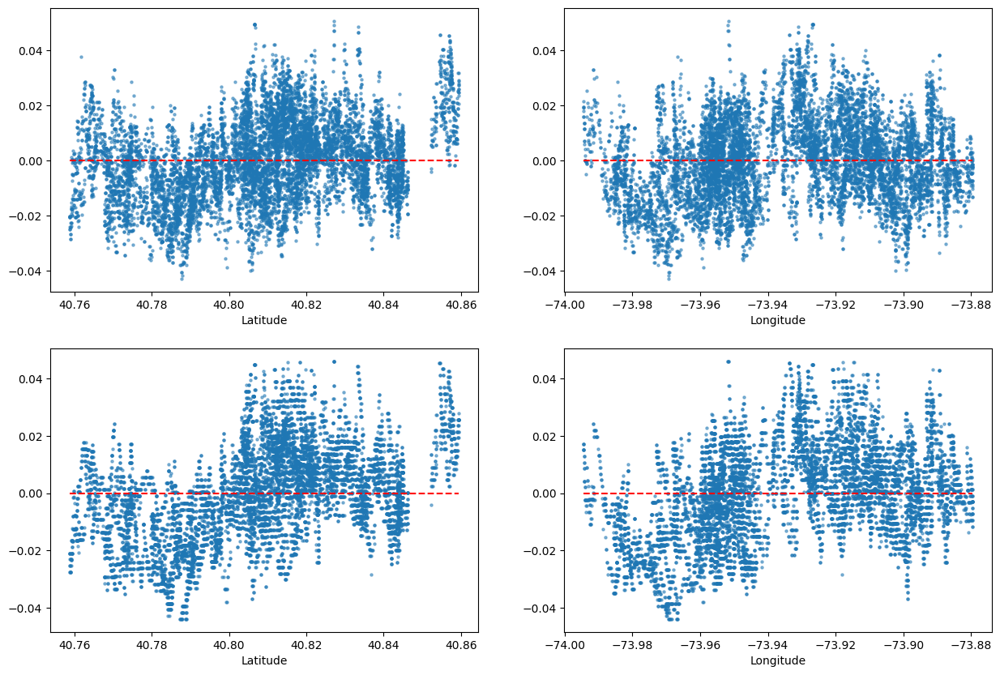

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
axes = axes.flatten()

axes[0].scatter(df['Latitude'], df_pred['residual'], alpha=0.5, s=5)
axes[0].hlines(y=0, xmin=df['Latitude'].min(), xmax=df['Latitude'].max(), color='red', linestyle='--')  # Reference line at y=0
axes[0].set_xlabel("Latitude")

axes[1].scatter(df['Longitude'], df_pred['residual'], alpha=0.5, s=5)
axes[1].hlines(y=0, xmin=df['Longitude'].min(), xmax=df['Longitude'].max(), color='red', linestyle='--')  # Reference line at y=0
axes[1].set_xlabel("Longitude")

axes[2].scatter(df['Latitude'], df_pred['UHI Index'] - df_pred['UHI Index'].mean(), alpha=0.5, s=5)
axes[2].hlines(y=0, xmin=df['Latitude'].min(), xmax=df['Latitude'].max(), color='red', linestyle='--')  # Reference line at y=0
axes[2].set_xlabel("Latitude")

axes[3].scatter(df['Longitude'], df_pred['UHI Index'] - df_pred['UHI Index'].mean(), alpha=0.5, s=5)
axes[3].hlines(y=0, xmin=df['Longitude'].min(), xmax=df['Longitude'].max(), color='red', linestyle='--')  # Reference line at y=0
axes[3].set_xlabel("Longitude")

plt.show()

In [ ]:
import libpysal
import esda
from splot.esda import moran_scatterplot
from shapely.geometry import Point

# Create spatial weights (5-nearest neighbors)
ground_df["geometry"] = ground_df.apply(lambda row: Point(row["Longitude"], row["Latitude"]), axis=1)
gdf = gpd.GeoDataFrame(ground_df, geometry="geometry", crs="EPSG:4326")

# fig, axes = plt.subplots(2, 3, figsize=(20, 15))
# axes = axes.flatten()


k_choices = [3, 5, 7, 9, 11, 15, 20, 25, 30]
i = 0

for k in k_choices:
    w = libpysal.weights.KNN.from_dataframe(gdf, k=k)
    w.transform = "R"  # Row standardization

    # Compute Moran's I
    moran = esda.Moran(gdf["UHI Index"], w)
    print(f"Moran's I: {moran.I}, p-value: {moran.p_sim}")

Moran's I: 0.9782149249899385, p-value: 0.001
Moran's I: 0.9692737233636249, p-value: 0.001
Moran's I: 0.9619088196659885, p-value: 0.001
Moran's I: 0.9551515844285662, p-value: 0.001
Moran's I: 0.9479585877267619, p-value: 0.001
Moran's I: 0.9336484130799709, p-value: 0.001
Moran's I: 0.9135081830669642, p-value: 0.001
Moran's I: 0.8943226576961534, p-value: 0.001
Moran's I: 0.8774720254329593, p-value: 0.001


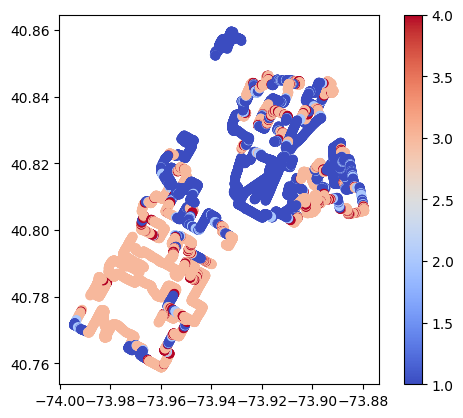

In [ ]:
lisa = esda.Moran_Local(gdf["UHI Index"], w)

# Plot significant clusters
gdf["lisa_cluster"] = lisa.q
gdf.plot(column="lisa_cluster", cmap="coolwarm", legend=True)
plt.show()

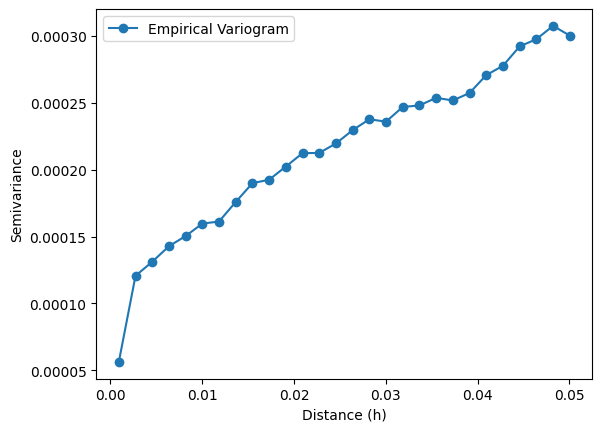

In [ ]:
import gstools as gs

# Define spatial coordinates
x, y = ground_df["Longitude"], ground_df["Latitude"]
z = ground_df["UHI Index"]

# Compute variogram
bin_center, gamma = gs.vario_estimate((x, y), z)

# Plot variogram
plt.plot(bin_center, gamma, "o-", label="Empirical Variogram")
plt.xlabel("Distance (h)")
plt.ylabel("Semivariance")
plt.legend()
plt.show()